<a href="https://colab.research.google.com/github/georgesteve/Code2/blob/master/PAth_planning_entrenamiento-resultado%201.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
!git clone https://github.com/AtsushiSakai/PythonRobotics.git


Cloning into 'PythonRobotics'...
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 5550 (delta 0), reused 0 (delta 0), pack-reused 5547
Receiving objects: 100% (5550/5550), 281.80 MiB | 41.02 MiB/s, done.
Resolving deltas: 100% (3274/3274), done.


In [0]:
ls

PythonRobotics/  sample_data/


In [4]:
cd PythonRobotics/PathPlanning/DubinsPath

/content/PythonRobotics/PathPlanning/DubinsPath


In [5]:
ls

dubins_path_planning.py  __init__.py


Start 


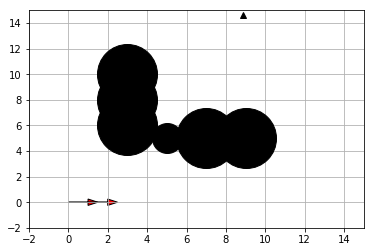

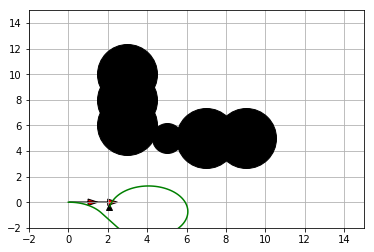

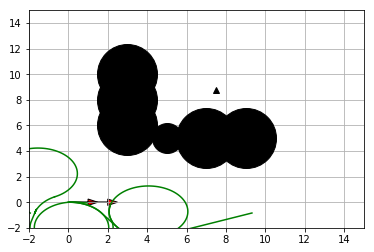

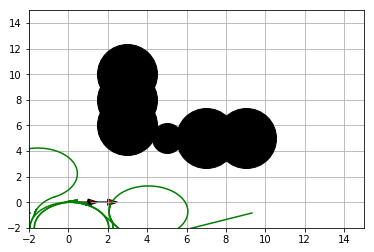

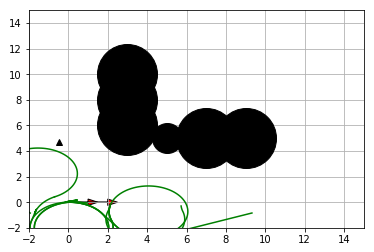

...

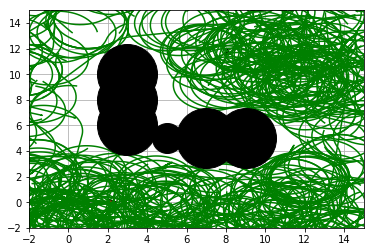

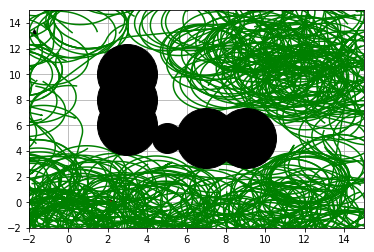

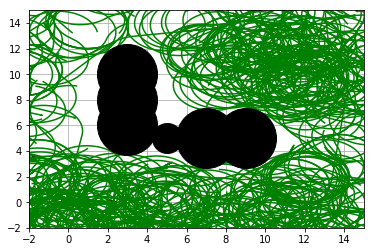

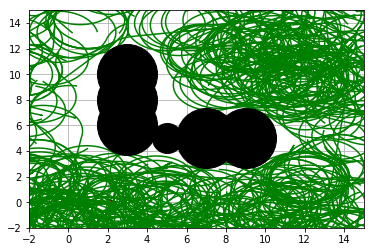

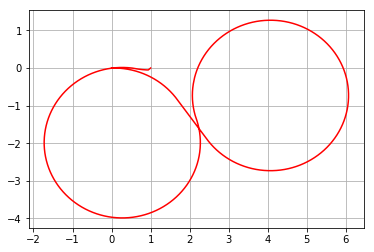

marca final
995.9016393442622
[0.0, 0.0]
244
244


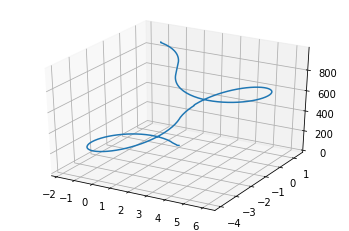

In [7]:
"""
Path Planning Sample Code with RRT for car like robot.
author: AtsushiSakai(@Atsushi_twi)
"""
import matplotlib.pyplot as plt
import numpy as np
import copy
import math
import random
import sys
import os
"""sys.path.append(os.path.dirname(os.path.abspath(__file__)) +
                "/../DubinsPath/")"""

try:
    import dubins_path_planning
except:
    raise


show_animation = True


class RRT():
    """
    Class for RRT Planning
    """

    def __init__(self, start, goal, obstacleList, randArea,
                 goalSampleRate=10, maxIter=1000):
        """
        Setting Parameter
        start:Start Position [x,y]
        goal:Goal Position [x,y]
        obstacleList:obstacle Positions [[x,y,size],...]
        randArea:Ramdom Samping Area [min,max]
        """
        self.start = Node(start[0], start[1], start[2])
        self.end = Node(goal[0], goal[1], goal[2])
        self.minrand = randArea[0]
        self.maxrand = randArea[1]
        self.goalSampleRate = goalSampleRate
        self.maxIter = maxIter
        self.obstacleList = obstacleList

    def Planning(self, animation=False):
        """
        Pathplanning
        animation: flag for animation on or off
        """

        self.nodeList = [self.start]
        for i in range(self.maxIter):
            rnd = self.get_random_point()
            nind = self.GetNearestListIndex(self.nodeList, rnd)

            newNode = self.steer(rnd, nind)

            if self.__CollisionCheck(newNode, self.obstacleList):
                self.nodeList.append(newNode)

            if animation and i % 5 == 0:
                self.DrawGraph(rnd=rnd)

        # generate coruse
        lastIndex = self.get_best_last_index()
        #  print(lastIndex)

        if lastIndex is None:
            return None

        path = self.gen_final_course(lastIndex)
        return path

    def pi_2_pi(self, angle):
        return (angle + math.pi) % (2 * math.pi) - math.pi

    def steer(self, rnd, nind):
        #  print(rnd)
        curvature = 0.5

        nearestNode = self.nodeList[nind]

        px, py, pyaw, mode, clen = dubins_path_planning.dubins_path_planning(
            nearestNode.x, nearestNode.y, nearestNode.yaw, rnd[0], rnd[1], rnd[2], curvature)

        newNode = copy.deepcopy(nearestNode)
        newNode.x = px[-1]
        newNode.y = py[-1]
        newNode.yaw = pyaw[-1]

        newNode.path_x = px
        newNode.path_y = py
        newNode.path_yaw = pyaw
        newNode.cost += clen
        newNode.parent = nind

        return newNode

    def get_random_point(self):

        if random.randint(0, 100) > self.goalSampleRate:
            rnd = [random.uniform(self.minrand, self.maxrand),
                   random.uniform(self.minrand, self.maxrand),
                   random.uniform(-math.pi, math.pi)
                   ]
        else:  # goal point sampling
            rnd = [self.end.x, self.end.y, self.end.yaw]

        return rnd

    def get_best_last_index(self):
        #  print("get_best_last_index")

        disglist = [self.calc_dist_to_goal(
            node.x, node.y) for node in self.nodeList]
        goalinds = [disglist.index(i) for i in disglist if i <= 0.1]
        #  print(goalinds)

        mincost = min([self.nodeList[i].cost for i in goalinds])
        for i in goalinds:
            if self.nodeList[i].cost == mincost:
                return i

        return None

    def gen_final_course(self, goalind):
        path = [[self.end.x, self.end.y]]
        while self.nodeList[goalind].parent is not None:
            node = self.nodeList[goalind]
            for (ix, iy) in zip(reversed(node.path_x), reversed(node.path_y)):
                path.append([ix, iy])
            #  path.append([node.x, node.y])
            goalind = node.parent
        path.append([self.start.x, self.start.y])
        return path

    def calc_dist_to_goal(self, x, y):
        return np.linalg.norm([x - self.end.x, y - self.end.y])

    def DrawGraph(self, rnd=None):  # pragma: no cover
        plt.clf()
        if rnd is not None:
            plt.plot(rnd[0], rnd[1], "^k")
        for node in self.nodeList:
            if node.parent is not None:
                plt.plot(node.path_x, node.path_y, "-g")

        for (ox, oy, size) in self.obstacleList:
            plt.plot(ox, oy, "ok", ms=30 * size)

        dubins_path_planning.plot_arrow(
            self.start.x, self.start.y, self.start.yaw)
        dubins_path_planning.plot_arrow(
            self.end.x, self.end.y, self.end.yaw)

        plt.axis([-2, 15, -2, 15])
        plt.grid(True)
        plt.pause(0.01)

    def GetNearestListIndex(self, nodeList, rnd):
        dlist = [(node.x - rnd[0]) ** 2
                 + (node.y - rnd[1]) ** 2
                 + (node.yaw - rnd[2] ** 2) for node in nodeList]
        minind = dlist.index(min(dlist))

        return minind

    def __CollisionCheck(self, node, obstacleList):

        for (ox, oy, size) in obstacleList:
            for (ix, iy) in zip(node.path_x, node.path_y):
                dx = ox - ix
                dy = oy - iy
                d = dx * dx + dy * dy
                if d <= size ** 2:
                    return False  # collision

        return True  # safe


class Node():
    """
    RRT Node
    """

    def __init__(self, x, y, yaw):
        self.x = x
        self.y = y
        self.yaw = yaw
        self.path_x = []
        self.path_y = []
        self.path_yaw = []
        self.cost = 0.0
        self.parent = None


def main():
    print("Start " )
    # ====Search Path with RRT====
    obstacleList = [
        (5, 5, 1),
        (3, 6, 2),
        (3, 8, 2),
        (3, 10, 2),
        (7, 5, 2),
        (9, 5, 2)
    ]  # [x,y,size(radius)]

    # Set Initial parameters
    start = [0.0, 0.0, np.deg2rad(0.0)]
    goal = [1.0, 0.0, np.deg2rad(0.0)]

    rrt = RRT(start, goal, randArea=[-2.0, 15.0], obstacleList=obstacleList)
    path = rrt.Planning(animation=show_animation)

    # Draw final path
    if show_animation:  # pragma: no cover
        rrt.DrawGraph()
        plt.plot([x for (x, y) in path], [y for (x, y) in path], '-r')
        plt.grid(True)
        plt.pause(0.001)
        plt.show()
    
    print("marca final")
    
    from mpl_toolkits.mplot3d import Axes3D


    fig = plt.figure()
    ax = fig.gca(projection='3d')
    h=1000
    t=0
    n=0
    
    tc=math.sqrt(h*2/9.81)
    tc=tc/(len(path)-2)
    
    
    z=[]
    

    #for x in path:
     # z.append(0.5*9.81*(t**2))
      #t=t+tc
    
    for x in path:
      z.append(h/(len(path))*n)
      n=n+1
    #print(len(path))
  
    #z=list(range(len(path)))
    
    #print(z)
    
    #z=z*(3)
    
    print(z[len(path)-1])
    print(path[len(path)-1])
    print(len(path))
    print(len(z))
    
    
    #z = [5.678 for (i) in z] 
    #z=np.linspace(0, h, len(path))
    x = [x for (x, y) in path]
    y = [y for (x, y) in path]
    ax.plot(x, y, z)
    plt.show()
    

if __name__ == '__main__':
    main()

In [0]:
*]# Modulos con los que trabajaremos
from mpl_toolkits.mplot3d import axes3d
import matplotlib.pyplot as plt
import numpy as np

# Creamos la figura
fig = plt.figure()


# Agrrgamos un plano 3D
ax1 = fig.add_subplot(111,projection='3d')





# Datos en array bi-dimensional
a = np.array([x for (x, y) in path])
b = np.array([y for (x, y) in path])
c = np.array([y for (x, y) in path])








# plot_wireframe nos permite agregar los datos x, y, z. Por ello 3D
# Es necesario que los datos esten contenidos en un array bi-dimensional
ax1.plot_wireframe(a,b,c)





# Mostramos el gráfico
plt.show()

NameError: ignored

<Figure size 432x288 with 0 Axes>

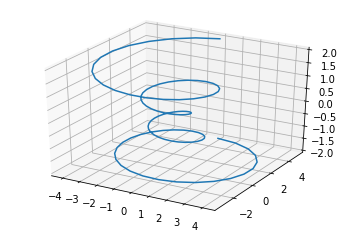

In [0]:
import matplotlib as mpl
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import matplotlib.pyplot as plt

fig = plt.figure()
ax = fig.gca(projection='3d')
theta = np.linspace(-4 * np.pi, 4 * np.pi, 100)
z = np.linspace(-2, 2, 100)
r = z**2 + 1
x = r * np.sin(theta)
y = r * np.cos(theta)
ax.plot(x, y, z)

plt.show()

In [0]:
a=5

b=3
a+b

8